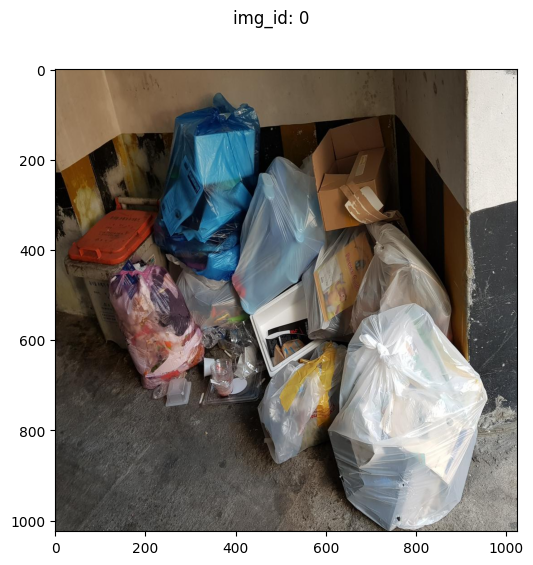

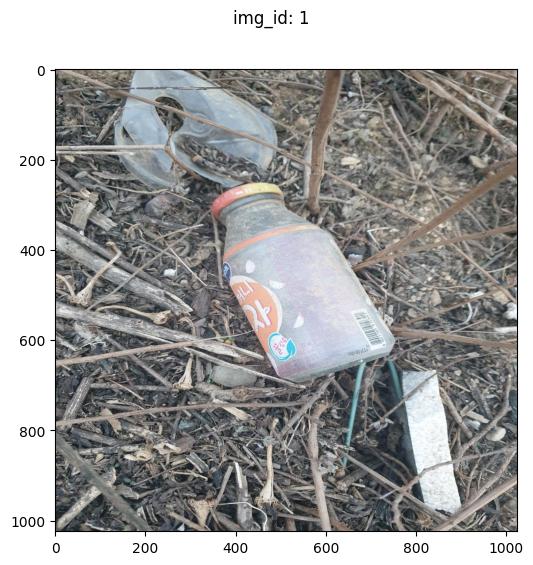

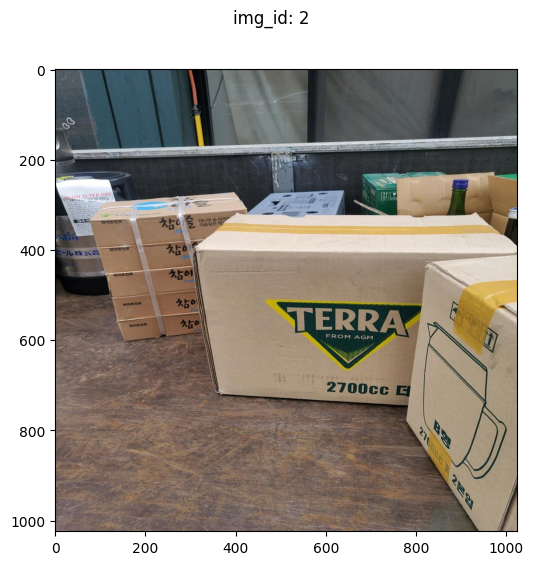

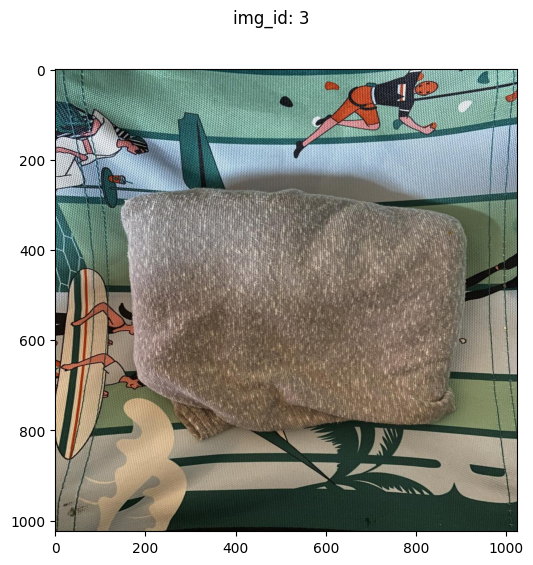

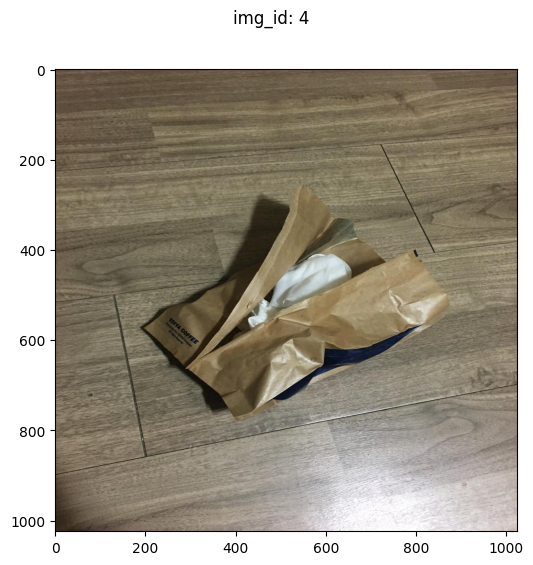

In [2]:
import matplotlib.pyplot as plt
from PIL import Image 
import pandas as pd
import json

json_file_path="/opt/ml/dataset/test.json" # 파일로드

with open(json_file_path,'r') as j:    # open : r - 읽기모드, w-쓰기모드, a-추가모드
    contents=json.loads(j.read())

#test이미지 확인용
for i in range(5):
    # read the image, creating an object
    img_no = str(i).zfill(4)
    img = Image.open(f"{data_dir}{img_no}.jpg")
    fig, axes = plt.subplots(1,1,figsize=(12, 6))
    fig.suptitle(f"img_id: {i}")
    fig = plt.imshow(img)


In [3]:
# validation data json 파일 확인, image 내 개체수 확인
json_file_path2="/opt/ml/dataset/val_new.json" # 파일로드

with open(json_file_path2,'r') as j:    # open : r - 읽기모드, w-쓰기모드, a-추가모드
    contents2=json.loads(j.read())
lst = []
for i in range(len(contents2['annotations'])):
    lst.append(contents2['annotations'][i]['id'])

print(lst)
len([i for i in lst if i < 23144])  # 기본 데이터셋 내 개체 수

[12, 13, 14, 15, 16, 17, 50, 116, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 153, 154, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 229, 246, 288, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 361, 362, 363, 364, 365, 366, 367, 368, 384, 385, 386, 387, 388, 389, 390, 392, 393, 394, 395, 396, 397, 398, 399, 428, 429, 430, 440, 441, 442, 443, 444, 445, 446, 447, 448, 449, 455, 456, 457, 472, 473, 474, 475, 476, 477, 478, 479, 480, 481, 482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492, 493, 494, 495, 496, 497, 498, 499, 500, 542, 543, 544, 545, 546, 547, 548, 549, 619, 620, 621, 630, 678, 718, 719, 753, 755, 782, 783, 784, 810, 811, 812, 813, 814, 815, 816, 817, 818, 819, 820, 821, 822, 823, 824, 825, 826, 827, 828, 829, 830, 831, 832, 833, 834, 835, 836, 837, 838, 839, 840, 841, 842, 843, 853, 854, 8

4361

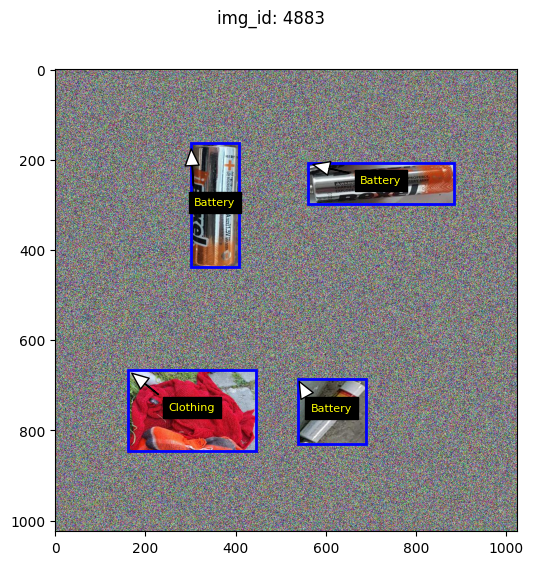

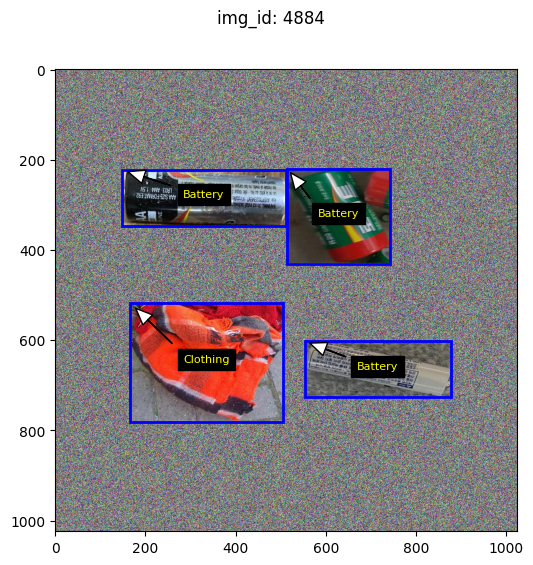

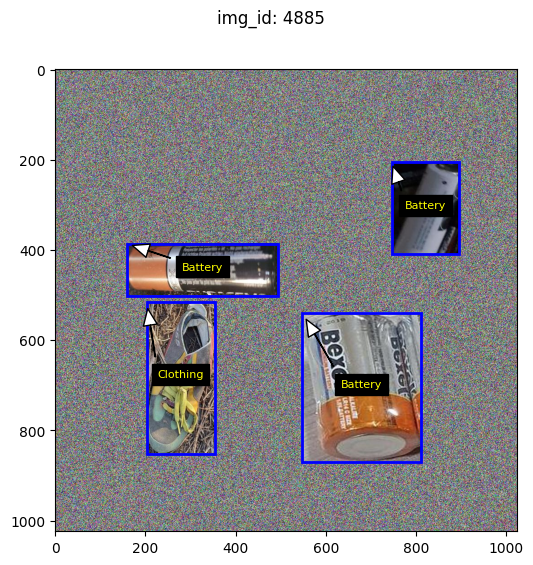

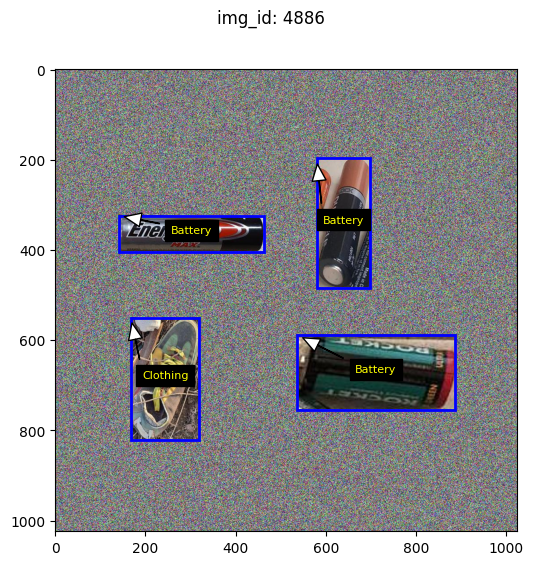

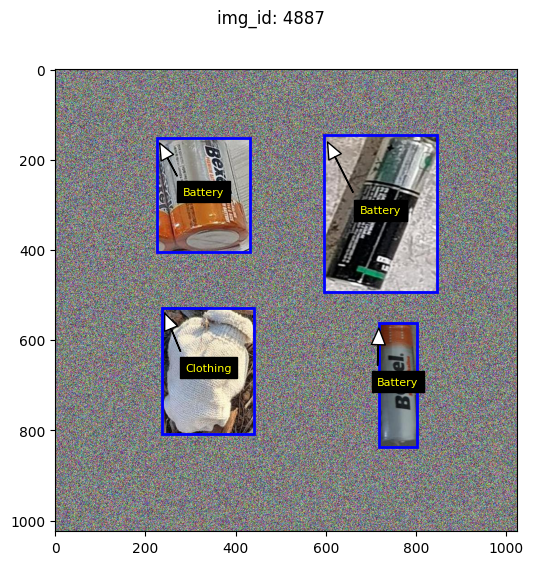

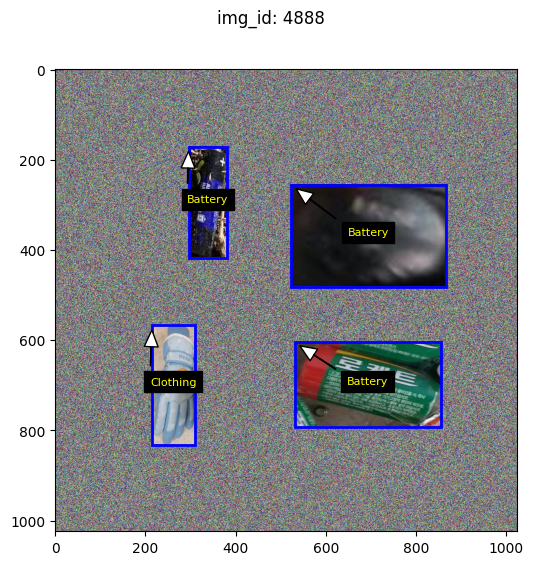

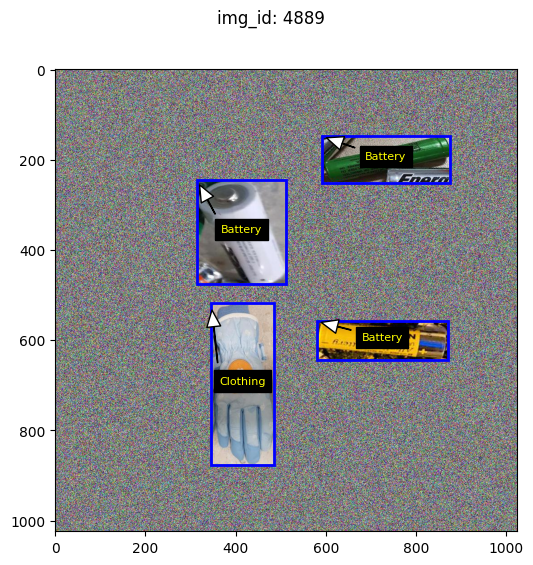

In [4]:
import matplotlib.pyplot as plt
from PIL import Image 
import pandas as pd
import json

json_file_path="/opt/ml/dataset/train_balance.json" # 파일로드

with open(json_file_path,'r') as j:    # open : r - 읽기모드, w-쓰기모드, a-추가모드
    contents=json.loads(j.read())

# contents.keys()
# contents['annotations'][0]['image_id'] # id
# contents['annotations'][0]['bbox'] # bbox


"""If in need, convert bounding box to matplotlib format."""
# Convert the bounding box (top-left x, top-left y, bottom-right x, bottom-right y)
# format to matplotlib format: ((upper-left x,upper-left y), width, height)

def bbox_to_rect(bbox, color):
    return plt.Rectangle(
        xy=(bbox[0], bbox[1]), width=bbox[2], height=bbox[3],
        fill=False, edgecolor=color, linewidth=2)


label_name = ["General trash", "Paper", "Paper pack", "Metal", 
              "Glass", "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing"]
data_dir = '/opt/ml/dataset/train/'
# /opt/ml/dataset/train/0000.jpg
n=23144-4361   # validation dataset 개체 수 제외한 숫자, 4883.jpg의 개체 annotion id 계산
for i in range(4883,4890):
    # read the image, creating an object
    img_no = str(i).zfill(4)
    img = Image.open(f"{data_dir}{img_no}.jpg")
    fig, axes = plt.subplots(1,1,figsize=(12, 6))
    fig.suptitle(f"img_id: {i}")
    fig = plt.imshow(img)
    while contents['annotations'][n]['image_id']==i:   # image_id check
        bbox = contents['annotations'][n]['bbox']  # xmin, ymin, w, h
        fig.axes.add_patch(bbox_to_rect(bbox,'blue'))  # 파란색 boundinb box 표시
        plt.annotate(label_name[contents['annotations'][n]['category_id']], xy=(bbox[0], bbox[1]), xytext=(bbox[0]+int(bbox[2]*0.5),bbox[1]+int(bbox[3]*0.5)),  # class명 표시
            fontsize=8, ha='center', color='yellow',backgroundcolor='black', arrowprops=dict(facecolor='white', width=0.3, shrink=0.1, headwidth=10))
        n+=1


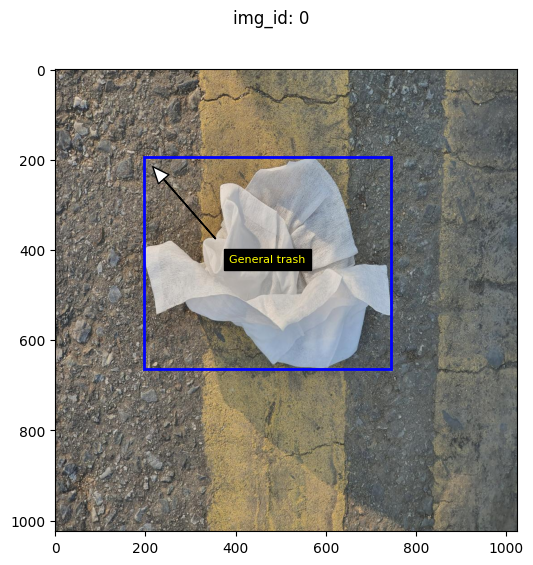

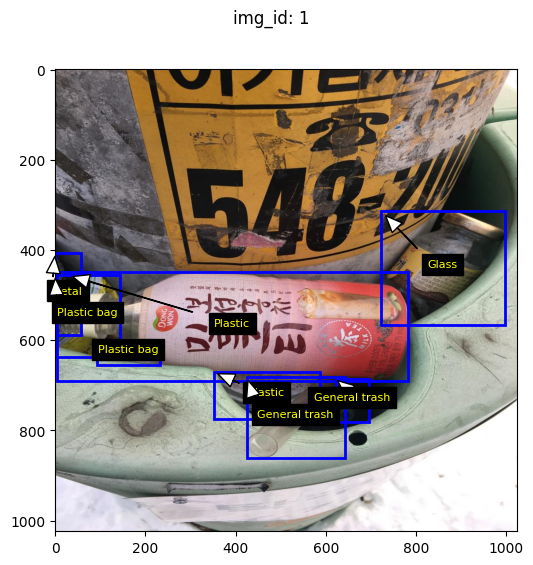

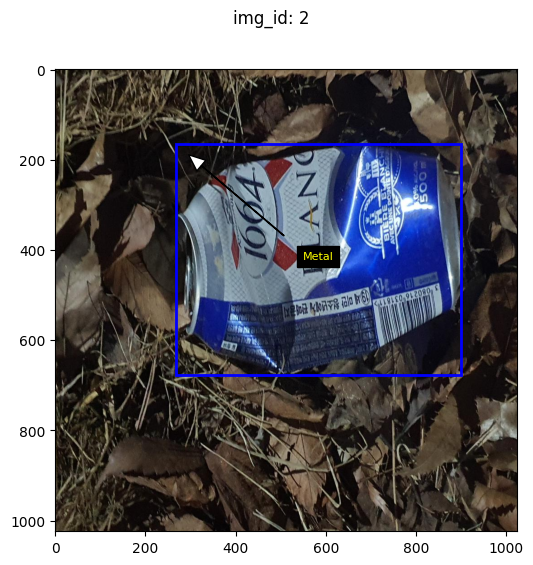

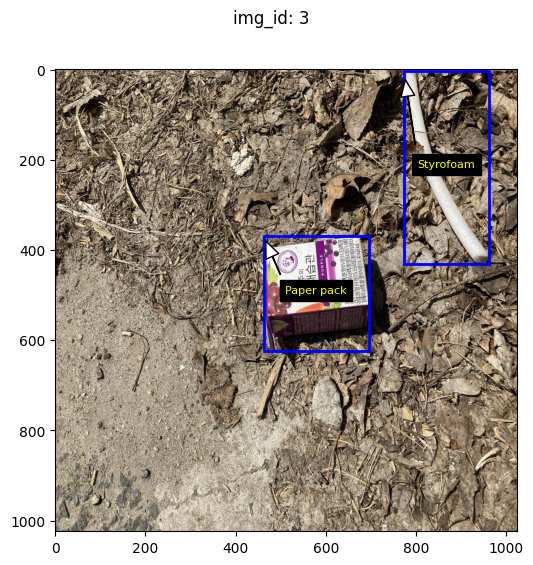

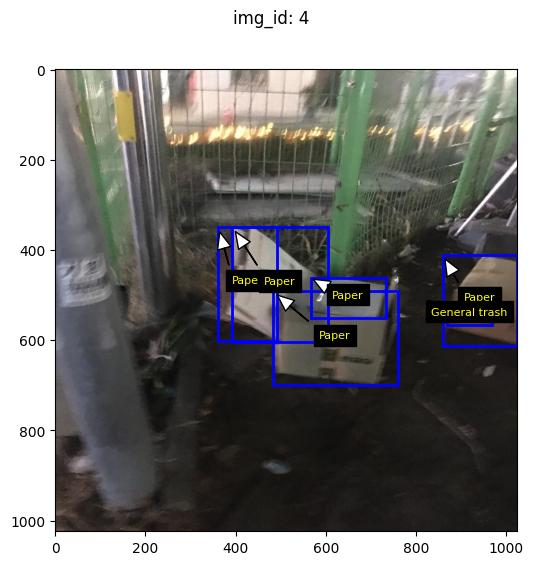

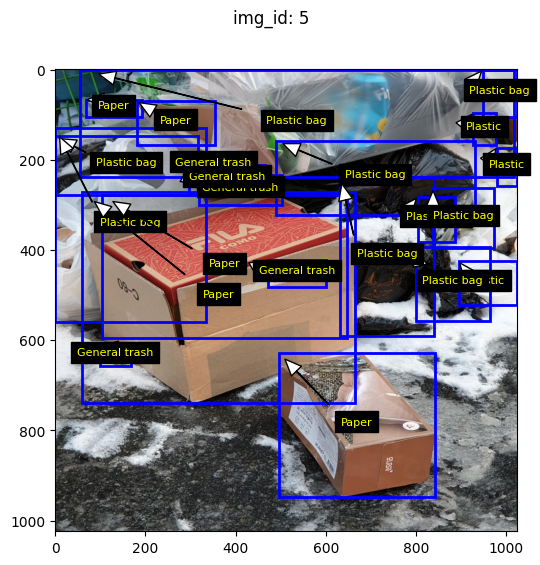

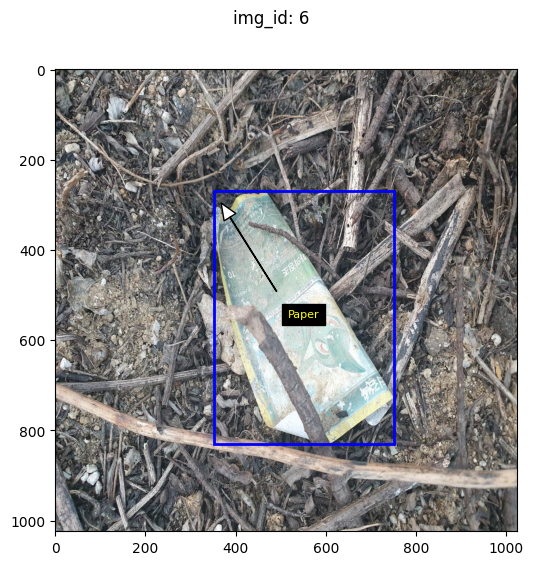

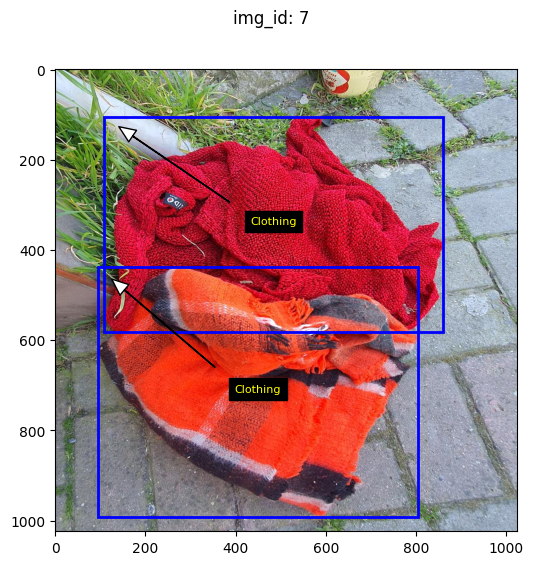

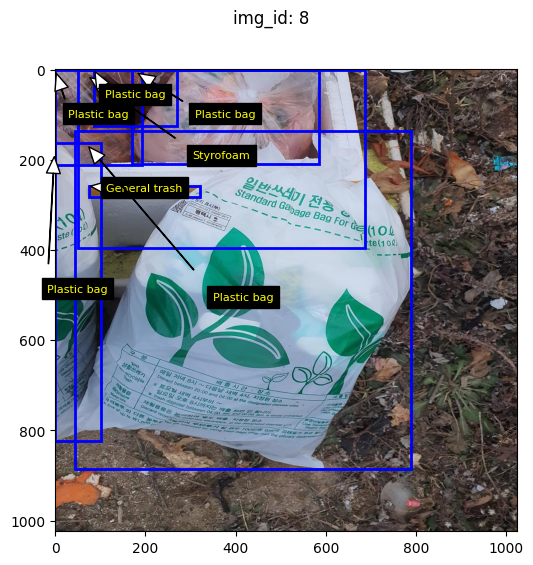

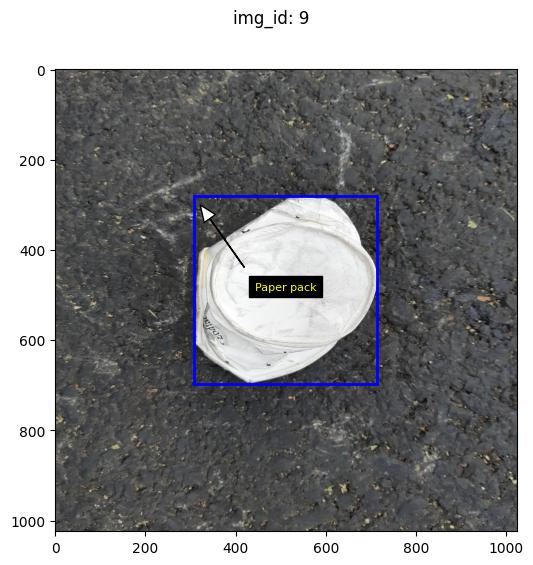

In [6]:
json_file_path="/opt/ml/dataset/train.json" # 파일로드

with open(json_file_path,'r') as j:    # open : r - 읽기모드, w-쓰기모드, a-추가모드
    contents=json.loads(j.read())
    
n=0   # validation dataset 개체 수 제외한 숫자, 4883.jpg의 개체 annotion id 계산
for i in range(10):
    # read the image, creating an object
    img_no = str(i).zfill(4)
    img = Image.open(f"{data_dir}{img_no}.jpg")
    fig, axes = plt.subplots(1,1,figsize=(12, 6))
    fig.suptitle(f"img_id: {i}")
    fig = plt.imshow(img)
    while contents['annotations'][n]['image_id']==i:   # image_id check
        bbox = contents['annotations'][n]['bbox']  # xmin, ymin, w, h
        fig.axes.add_patch(bbox_to_rect(bbox,'blue'))  # 파란색 boundinb box 표시
        plt.annotate(label_name[contents['annotations'][n]['category_id']], xy=(bbox[0], bbox[1]), xytext=(bbox[0]+int(bbox[2]*0.5),bbox[1]+int(bbox[3]*0.5)),  # class명 표시
            fontsize=8, ha='center', color='yellow',backgroundcolor='black', arrowprops=dict(facecolor='white', width=0.3, shrink=0.1, headwidth=10))
        n+=1

In [ ]:
# matplotlib==3.7.1
# IPython==8.12.0
# plotly==5.14.1
# pillow==9.5.0
# opencv-python==4.7.0.72
# pycocotools==2.0.6
# tqdm==4.65.0
# ipywidgets==8.0.6
# jupyterlab==3.6.3
# seaborn==0.12.0

In [3]:
!pip install plotly==5.14.1

  Using cached plotly-5.14.1-py2.py3-none-any.whl (15.3 MB)
  Using cached tenacity-8.2.2-py3-none-any.whl (24 kB)


In [2]:
import pandas as pd; pd.options.mode.chained_assignment = None
import numpy as np

# Built In Imports

from datetime import datetime
from glob import glob
import warnings
import IPython
import urllib
import zipfile
import pickle
import shutil
import string
import math
import tqdm
import time
import os
import gc
import re

# Visualization Imports

from matplotlib.colors import ListedColormap
import matplotlib.patches as patches
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from PIL import Image
import matplotlib
import plotly
import PIL
import cv2

from pycocotools.coco import COCO

# Other Imports

from tqdm.notebook import tqdm

LABELCOLORS = [px.colors.label_rgb(px.colors.convert_to_RGB_255(x)) for x in sns.color_palette("Spectral", 10)]
LABELCOLORSWOUTNOFINDING = LABELCOLORS[:8]+LABELCOLORS[9:]

In [3]:
coco = COCO('/opt/ml/dataset/train.json')


loading annotations into memory...
Done (t=0.16s)
creating index...
index created!


In [4]:
coco.getImgIds()[-1]

4882

In [6]:
traindf = pd.DataFrame()
imageids = []
classname = []
classid = []
x_min = []
y_min = []
x_max = []
y_max = []
classes = ["General trash", "Paper", "Paper pack", "Metal","Glass", "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing"]

for imageid in coco.getImgIds():
    imageinfo = coco.loadImgs(imageid)[0]
    annids = coco.getAnnIds(imgIds=imageinfo['id'])
    anns = coco.loadAnns(annids)
    filename = imageinfo['file_name']

    for ann in anns:
        imageids.append(filename)
        classname.append(classes[ann['category_id']])
        classid.append(ann['category_id'])
        x_min.append(float(ann['bbox'][0]))
        y_min.append(float(ann['bbox'][1]))
        x_max.append(float(ann['bbox'][0]) + float(ann['bbox'][2]))
        y_max.append(float(ann['bbox'][1]) + float(ann['bbox'][3]))

traindf['imageid'] = imageids
traindf['classname'] = classname
traindf['classid'] = classid
traindf['xmin'] = x_min
traindf['ymin'] = y_min
traindf['xmax'] = x_max
traindf['ymax'] = y_max

In [7]:
len(traindf)
traindf.tail()

,imageid,classname,classid,xmin,ymin,xmax,ymax
23139,train/4882.jpg,Plastic,5,0.0,116.2,944.1,930.3
23140,train/4882.jpg,Plastic bag,7,302.1,439.3,567.3,655.4
23141,train/4882.jpg,General trash,0,511.3,451.1,570.0,481.3
23142,train/4882.jpg,Paper,1,255.0,421.4,526.7,616.5
23143,train/4882.jpg,Paper,1,145.4,295.4,565.6,651.5


In [8]:
traindf.head()

,imageid,classname,classid,xmin,ymin,xmax,ymax
0,train/0000.jpg,General trash,0,197.6,193.7,745.4,663.4
1,train/0001.jpg,Metal,3,0.0,407.4,57.6,588.0
2,train/0001.jpg,Plastic bag,7,0.0,455.6,144.6,637.2
3,train/0001.jpg,Glass,4,722.3,313.4,996.6,565.3
4,train/0001.jpg,Plastic,5,353.2,671.0,586.9,774.4


In [9]:
fig = px.histogram(traindf.imageid.value_counts(),
                   log_y=False, color_discrete_sequence=['indianred'], opacity=0.7,
                   labels={"value":"Number of Annotations Per Image"},
                   title="<b>DISTRIBUTION OF # OF ANNOTATIONS PER IMAGE  "
                         "<i><sub>(Log Scale for Y-Axis)</sub></i></b>",
                   )

fig.update_layout(showlegend=False,
                  xaxis_title="<b>Number of Unique Images</b>",
                  yaxis_title="<b>Count of All Object Annotations</b>",)

fig.show()

In [10]:
fig = px.histogram(traindf.groupby('imageid')["classid"].unique().apply(lambda x: len(x)),log_y=False, color_discrete_sequence=['skyblue'], 
                   opacity=0.7,labels={"value":"Number of Unique class"},title="<b>DISTRIBUTION OF # OF Unique Class PER IMAGE "
                   "<i><sub>(Log Scale for Y-Axis)</sub></i></b>"
                   )

fig.update_layout(showlegend=False,
                  xaxis_title="<b>Number of Unique CLASS</b>",
                  yaxis_title="<b>Count of Unique IMAGE</b>",
                 )

fig.show()

In [11]:
fig = px.bar(traindf.classname.value_counts().sort_index(),
             color=traindf.classname.value_counts().sort_index().index, opacity=0.85,
             color_discrete_sequence=LABELCOLORS, log_y=False, # 차이 명확하게 표시하려면 False
             labels={"y":"Annotations Per Class", "x":""},
             title="<b>Annotations Per Class</b>")

fig.update_layout(legend_title=None,
                  xaxis_title="",
                  yaxis_title="<b>Annotations Per Class</b>"
                  )

fig.show()

In [5]:
fig = px.bar(traindf.classname.value_counts().sort_index(),
             color=traindf.classname.value_counts().sort_index().index, opacity=0.85,
             color_discrete_sequence=LABELCOLORS, log_y=False, # 차이 명확하게 표시하려면 False
             labels={"y":"Annotations Per Class", "x":""},
             title="<b>Annotations Per Class</b>")

fig.update_layout(legend_title=None,
                  xaxis_title="",
                  yaxis_title="<b>Annotations Per Class</b>"
                  )

fig.show()
# 클래스 불균형 해결 -> 배터리 8, 옷 9, 유리 4, 메탈 3, 종이팩 2, 스티로폼 6 총 2000+ 

  0%|          | 0/23144 [00:00<?, ?it/s]

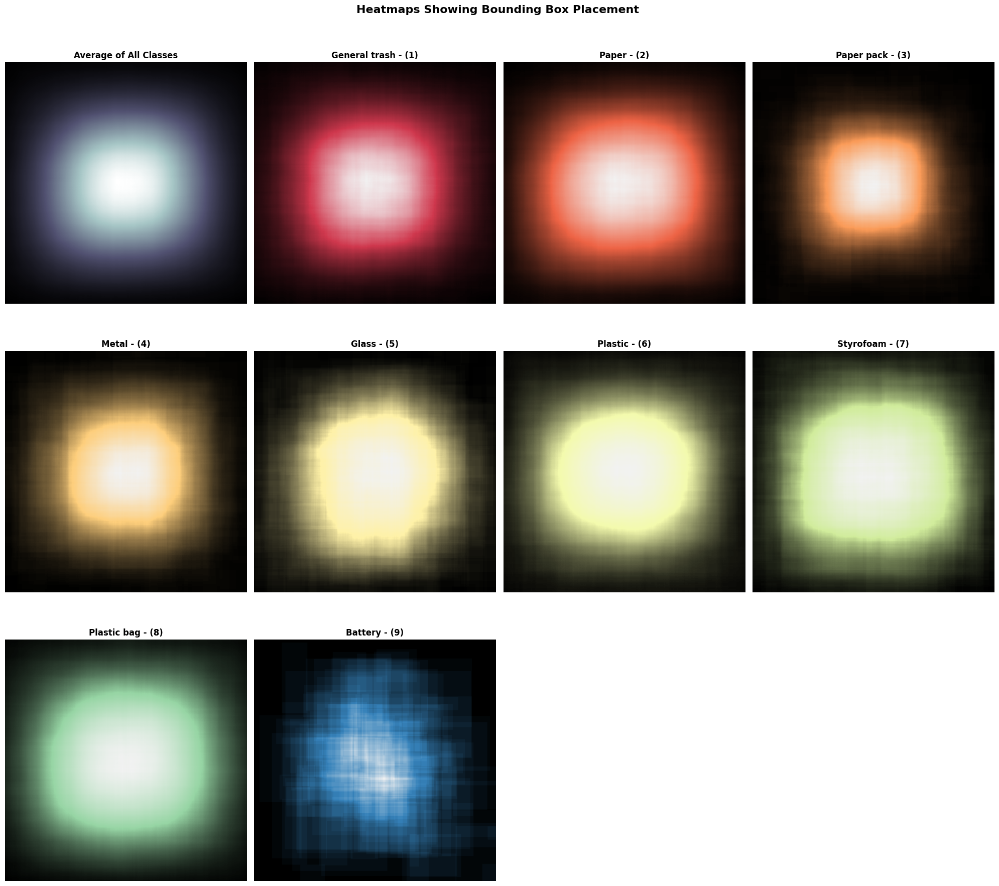

In [12]:
bboxdf = pd.DataFrame()
bboxdf['classid'] = traindf['classid'].values
bboxdf['classname'] = traindf['classname'].values
bboxdf['xmin'] = traindf['xmin'].values
bboxdf['xmax'] = traindf['xmax'].values
bboxdf['ymin'] = traindf['ymin'].values
bboxdf['ymax'] = traindf['ymax'].values
bboxdf['fracxmin'] = traindf['xmin'].values / 1024
bboxdf['fracxmax'] = traindf['xmax'].values / 1024
bboxdf['fracymin'] = traindf['ymin'].values / 1024
bboxdf['fracymax'] = traindf['ymax'].values / 1024
avesrcimg_height = 1024
avesrcimg_width = 1024

# DEFAULT

HEATMAPSIZE = (avesrcimg_height, avesrcimg_width, 14)

# Initialize

heatmap = np.zeros((HEATMAPSIZE), dtype=np.int16)
bboxnp = bboxdf[["classid", "fracxmin", "fracxmax", "fracymin", "fracymax"]].to_numpy()
bboxnp[:, 1:3] *= avesrcimg_width
bboxnp[:, 3:5] *= avesrcimg_height
bboxnp = np.floor(bboxnp).astype(np.int16)

# Color map stuff

custom_cmaps = [
    matplotlib.colors.LinearSegmentedColormap.from_list(
        colors=[(0.,0.,0.), c, (0.95,0.95,0.95)],
        name=f"custom{i}") for i,c in enumerate(sns.color_palette("Spectral", 10))
]

custom_cmaps.pop(8) # Remove No-Finding

for row in tqdm(bboxnp, total=bboxnp.shape[0]):
    heatmap[row[3]:row[4]+1, row[1]:row[2]+1, row[0]] += 1

fig = plt.figure(figsize=(20,25))
plt.suptitle("Heatmaps Showing Bounding Box Placement ", fontweight="bold", fontsize=16)

for i in range(10):
    plt.subplot(4, 4, i+1)
    if i==0:
        plt.imshow(heatmap.mean(axis=-1), cmap="bone")
        plt.title(f"Average of All Classes", fontweight="bold")

    else:
        plt.imshow(heatmap[:, :, i-1], cmap=custom_cmaps[i-1])
        plt.title(f"{classes[i-1]} - ({i})", fontweight="bold")

    plt.axis(False)

fig.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.show()


In [45]:
# Update bbox dataframe to make this easier

bboxdf["fracbboxarea"] = (bboxdf["fracxmax"]-bboxdf["fracxmin"])*(bboxdf["fracymax"]-bboxdf["fracymin"])

# bboxdf["classidasstr"] = bboxdf["classid"].map(classes)

display(bboxdf.head())

fig = px.box(bboxdf.sort_values(by="classname"), x="classname", y="fracbboxarea", color="classname",
             color_discrete_sequence=LABELCOLORSWOUTNOFINDING, notched=True,
             labels={"classname":"Class Name", "fracbbox_area":"BBox Area (%)"},
             title="<b>DISTRIBUTION OF BBOX AREAS AS % OF SOURCE IMAGE AREA  "
                   "<i><sub>(Some Upper Outliers Excluded For Better Visualization)</sub></i></b>")

fig.update_layout(showlegend=True,
                  yaxis_range=[-0.025,0.4],
                  legend_title_text=None,
                  xaxis_title="",
                  yaxis_title="<b>Bounding Box Area %</b>"
                  )

fig.show()

,classid,classname,xmin,xmax,ymin,ymax,fracxmin,fracxmax,fracymin,fracymax,fracbboxarea
0,0,General trash,197.6,745.4,193.7,663.4,0.192969,0.727930,0.189160,0.647852,0.245382
1,3,Metal,0.0,57.6,407.4,588.0,0.000000,0.056250,0.397852,0.574219,0.009921
2,7,Plastic bag,0.0,144.6,455.6,637.2,0.000000,0.141211,0.444922,0.622266,0.025043
3,4,Glass,722.3,996.6,313.4,565.3,0.705371,0.973242,0.306055,0.552051,0.065895
4,5,Plastic,353.2,586.9,671.0,774.4,0.344922,0.573145,0.655273,0.756250,0.023045


In [49]:
# Aspect Ratio is Calculated as Width/Height

bboxdf["aspectratio"] = (bboxdf["xmax"]-bboxdf["xmin"])/(bboxdf["ymax"]-bboxdf["ymin"])

# Display average means for each class_id so we can examine the newly created Aspect Ratio Column

display(bboxdf.groupby("classname").mean())

# Generate the bar plot

fig = px.bar(x=sorted(classes), y=bboxdf.groupby("classname").mean()["aspectratio"],
             color=sorted(classes), opacity=0.85,
             color_discrete_sequence=LABELCOLORSWOUTNOFINDING,
             labels={"x":"Class Name", "y":"Aspect Ratio (W/H)"},
             title="<b>Aspect Ratios For Bounding Boxes By Class</b>",)

fig.update_layout(
                  yaxis_title="<b>Aspect Ratio (W/H)</b>",
                  xaxis_title=None,
                  legend_title_text=None)

fig.add_hline(y=1, line_width=2, line_dash="dot",
              annotation_font_size=10,
              annotation_text="<b>SQUARE ASPECT RATIO</b>",
              annotation_position="bottom left",
              annotation_font_color="black")

fig.add_hrect(y0=0, y1=0.5, line_width=0, fillcolor="red", opacity=0.125,
              annotation_text="<b>>2:1 VERTICAL RECTANGLE REGION</b>",
              annotation_position="bottom right",
              annotation_font_size=10,
              annotation_font_color="red")

fig.add_hrect(y0=2, y1=3.5, line_width=0, fillcolor="green", opacity=0.04,
              annotation_text="<b>>2:1 HORIZONTAL RECTANGLE REGION</b>",
              annotation_position="top right",
              annotation_font_size=10,
              annotation_font_color="green")

fig.show()

,classid,xmin,xmax,ymin,ymax,fracxmin,fracxmax,fracymin,fracymax,fracbboxarea,aspectratio
classname,,,,,,,,,,,
Battery,8.0,411.002516,639.876730,432.148428,647.143396,0.401370,0.624880,0.422020,0.631976,0.048075,1.428327
Clothing,9.0,335.697222,730.380128,346.516026,738.193590,0.327829,0.713262,0.338395,0.720892,0.180578,1.228279
General trash,0.0,392.753707,618.990923,404.283737,619.753833,0.383549,0.604483,0.394808,0.605228,0.075207,1.433186
Glass,4.0,410.682383,616.770265,398.284827,670.155703,0.401057,0.602315,0.388950,0.654449,0.066126,1.043987
Metal,3.0,396.325962,647.355235,377.684722,634.891774,0.387037,0.632183,0.368833,0.620011,0.087399,1.239462
Paper,1.0,384.916137,648.767191,384.417774,621.110941,0.375895,0.633562,0.375408,0.606554,0.087780,1.391648
Paper pack,2.0,387.955741,632.852062,417.834671,637.919175,0.378863,0.618020,0.408042,0.622968,0.072590,1.296333
Plastic,5.0,400.650357,640.025382,395.486035,626.166667,0.391260,0.625025,0.386217,0.611491,0.077239,1.288092
Plastic bag,7.0,377.764175,653.141213,349.603109,650.812688,0.368910,0.637833,0.341409,0.635559,0.105245,1.106761


In [2]:
# val set 만들기
import json
import shutil
json_file_path="/opt/ml/Yet-Another-EfficientDet-Pytorch/datasets/coco/annotations/instances_val2017.json" # 파일로드
with open(json_file_path,'r') as j:
    contents=json.loads(j.read())  # open : r - 읽기모드, w-쓰기모드, a-추가모드 
img_list = contents['images']
base_dir = '/opt/ml/Yet-Another-EfficientDet-Pytorch/datasets/coco/'
img_dir = base_dir+'train/'
to_img_dir = base_dir+'val/'
for img in img_list:
    f_name = img['file_name']
    f_name = f_name.split('/')[1]
    shutil.move(img_dir+f_name,to_img_dir)